# Anomaly Detection

<a href="https://colab.research.google.com/github/netdata/netdata-community/blob/main/netdata-agent-api/netdata-pandas/anomaly_detection.ipynb" target="_blank"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In this notebook we will use the [netdata-pandas](https://github.com/netdata/netdata-pandas) Python package to pull some recent data from a demo Netdata server and run some anomaly detection algorithims from the [ADTK](https://adtk.readthedocs.io/en/stable/) package. 

**Note**: you can click the "Open in Colab" button above to open this notebook in [Google Colab](https://colab.research.google.com/notebooks/intro.ipynb#recent=true) where you can just get going with it without having to set up python enviornments or any messy stuff like that.

In [53]:
# if you need to, uncomment below to install netdata-pandas and adtk packages
#!pip install netdata-pandas==0.0.27 adtk==0.6.2

In [54]:
import random
import numpy as np
import pandas as pd
from adtk.detector import (
    QuantileAD, InterQuartileRangeAD, PcaAD, PersistAD, LevelShiftAD, VolatilityShiftAD, OutlierDetector, 
    RegressionAD, MinClusterDetector, AutoregressionAD, SeasonalAD)
from sklearn.neighbors import LocalOutlierFactor
from sklearn.linear_model import LinearRegression
from sklearn.cluster import KMeans
from adtk.visualization import plot
from netdata_pandas.data import get_data


def init_model(model, metric=None):
    """Helper function to initialize a ADTK model.
    """
    if model == 'quantile':
        detector = QuantileAD()
    elif model == 'iqr':
        detector = InterQuartileRangeAD()
    elif model == 'pca':
        detector = PcaAD()
    elif model == 'persist':
        detector = PersistAD()
    elif model == 'level':
        detector = LevelShiftAD(c=6.0, side='both', window=5)
    elif model == 'volatility':
        detector = VolatilityShiftAD(c=6.0, side='both', window=30)
    elif model == 'lof':
        detector = OutlierDetector(LocalOutlierFactor(contamination=0.05))
    elif model == 'regression':
        detector = RegressionAD(regressor=LinearRegression(), target=metric, c=3.0)
    elif model == 'kmeans':
        detector = MinClusterDetector(KMeans(n_clusters=2))
    elif model == 'ar':
        detector = AutoregressionAD(n_steps=7*2, step_size=24, c=3.0)
    elif model == 'seasonal':
        detector = SeasonalAD(c=3.0, side="both")
    else:
        detector = PcaAD()
    return detector


def preprocess_df(df, diff, smooth_n):
    """Apply various preprocessing steps to the dataframe.
    """
    if smooth_n > 1:
        df = df.rolling(smooth_n).mean()
    if diff:
        df = df.diff(1)
    return df


Lets pull the data from a demo node for a subset of charts for the last 60 minutes.

In [55]:
# inputs

# pick a random demo node to pull from
host = [random.choice(['london.my-netdata.io', 'newyork.my-netdata.io', 'cdn77.my-netdata.io', 'octopuscs.my-netdata.io'])]
charts = [
    'system.cpu', 'system.load', 'system.io', 'system.ram', 'system.net', 'system.ip', 'system.processes', 'system.ctxt', 
    'system.forks', 'system.active_processes', 'system.idlejitter', 'system.intr', 'system.softnet_stat', 'system.entropy']
model = 'ar'
before = 0
after = -60*60*4 # lets look at last 4 hours of data
smooth_n = 30 # used to smooth the raw data a little
diff = False # True to take differences before doing anomaly detection

In [56]:
# get the data
print(f'... data pulled from http://{host[0]}')
df = get_data(hosts=host, charts=charts, after=after, before=before, index_as_datetime=True, nunique_thold=0.05)
print(df.shape)
df.head()

... data pulled from http://octopuscs.my-netdata.io
(14401, 19)


,system.cpu|system,system.ctxt|switches,system.forks|started,system.idlejitter|average,system.idlejitter|max,system.intr|interrupts,system.io|in,system.io|out,system.ip|received,system.ip|sent,system.load|load1,system.load|load15,system.load|load5,system.net|received,system.net|sent,system.ram|cached,system.ram|free,system.ram|used,system.softnet_stat|processed
time_idx,,,,,,,,,,,,,,,,,,,
2020-10-27 07:50:15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,36.44,14.84,26.47,NaN,NaN,NaN,NaN,NaN,NaN
2020-10-27 07:50:16,8.651399,4303.850,6.640695,206.0,1582.0,2320.568,2.58976,-85.32675,3340.555,-110.14039,36.44,14.84,26.47,7.161224,-6.575368,2733.680,243.8594,12892.797,731.0117
2020-10-27 07:50:17,7.556675,4358.893,3.722276,255.0,2563.0,2337.009,1.41024,-1.41024,3415.851,-117.31919,36.44,14.84,26.47,7.544372,-13.907407,2733.684,243.6484,12893.004,762.4732
2020-10-27 07:50:18,8.478803,4408.443,1.996896,236.0,2793.0,2374.517,0.00000,0.00000,3329.351,-117.87780,36.44,14.84,26.47,8.250437,-15.477790,2733.684,243.8008,12892.852,740.0232
2020-10-27 07:50:19,9.743590,4318.295,2.007834,243.0,2963.0,2346.220,0.00000,0.00000,3322.292,-113.66160,36.44,14.84,26.47,7.954135,-12.150330,2733.684,243.8633,12892.789,738.8091


## Anomaly Detection!

Now we have our data in a [Pandas](https://pandas.pydata.org/pandas-docs/stable/index.html) `DataFrame` lets loop over each metric we have, run an anomaly detection algorithm as defined by our `model` parameter and the defaults set in the `init_model()` function. 

As we loop over each metric we will use the [fit_detect()](https://adtk.readthedocs.io/en/stable/api/detectors.html#adtk.detector.AutoregressionAD.fit_detect) method to both fit a model and use it to detect anomalies on the whole batch of data (so this is a bit different to streaming or online anomaly detection). 

Then we will plot both the preprocessed metric time series itself and any anomalies flagged by the model as red dots on that time series.

Typically we will see some "red dots" we agree with as obvious or even more nuanced anomalies in the data, as well as many we think are obvious [false positives](https://en.wikipedia.org/wiki/False_positives_and_false_negatives#False_positive_error) and things we would not really consider anomalies at all. 

This just serves to show that anomaly detection itself can be quite subjective, specific to the individual metrics and data you throw at it and not quite something that can be fully automated away just yet :)

That said, tools like [ADTK](https://adtk.readthedocs.io/en/stable/index.html), [PyOD](https://pyod.readthedocs.io/en/latest/), [PySAD](https://pysad.readthedocs.io/en/latest/) and [many more](https://github.com/rob-med/awesome-TS-anomaly-detection) can be very useful in making it easier to explore your data and maybe find some useful insights. 

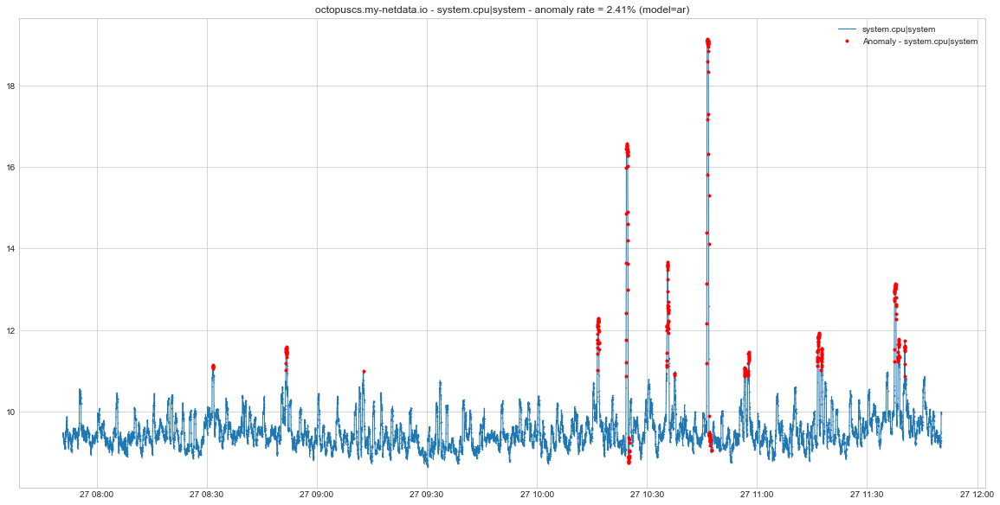

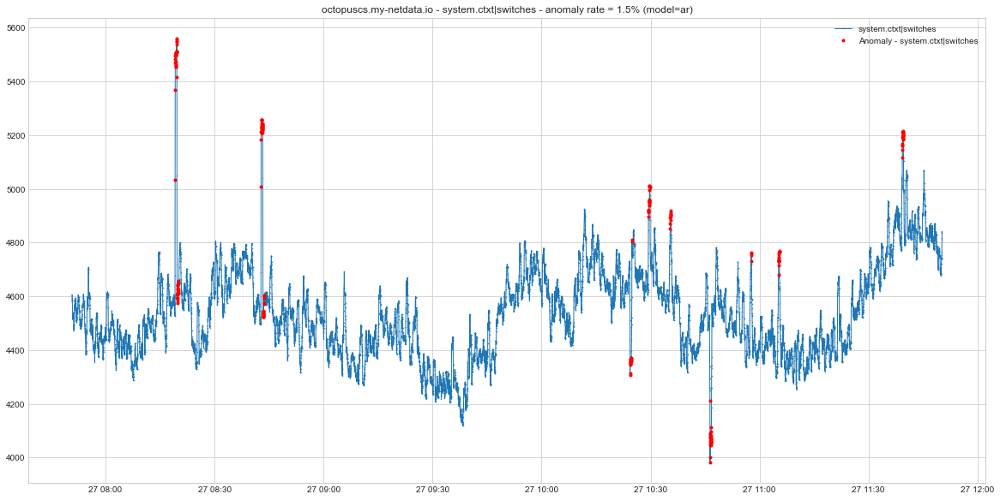

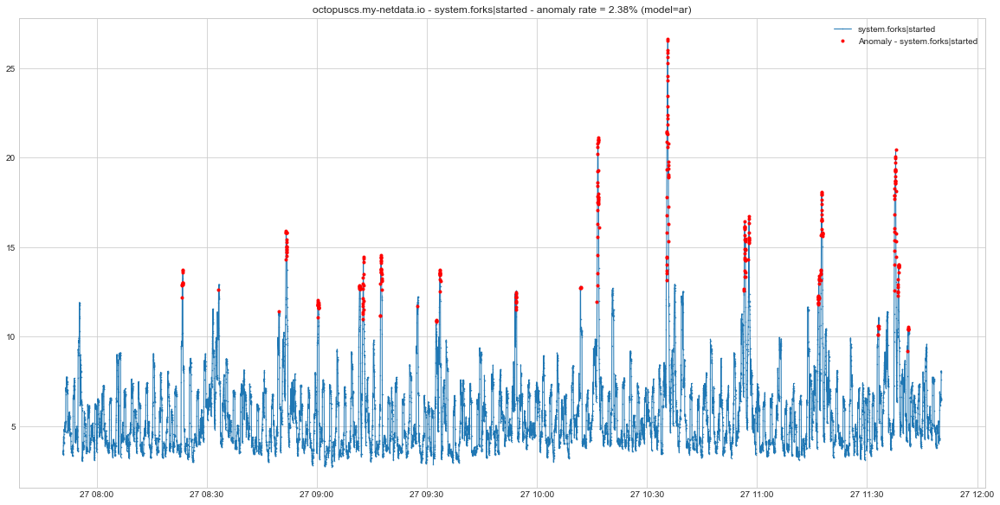

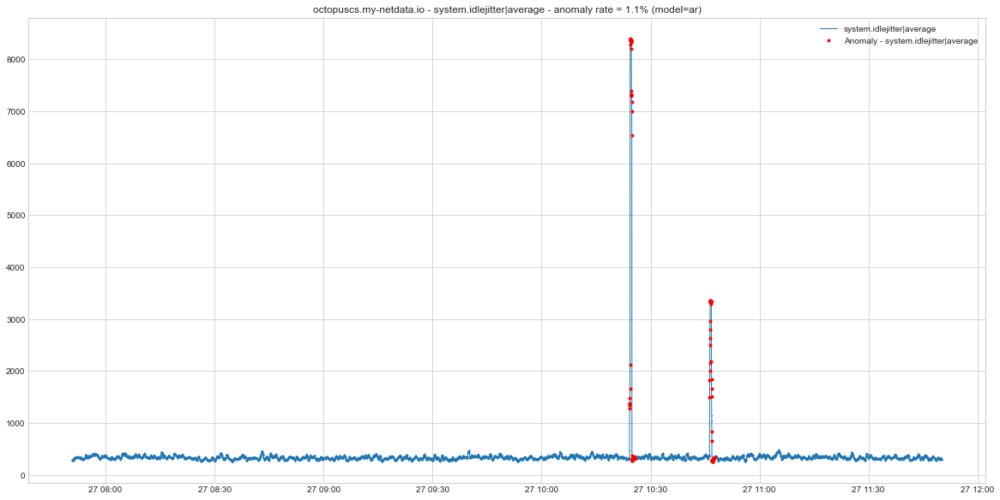

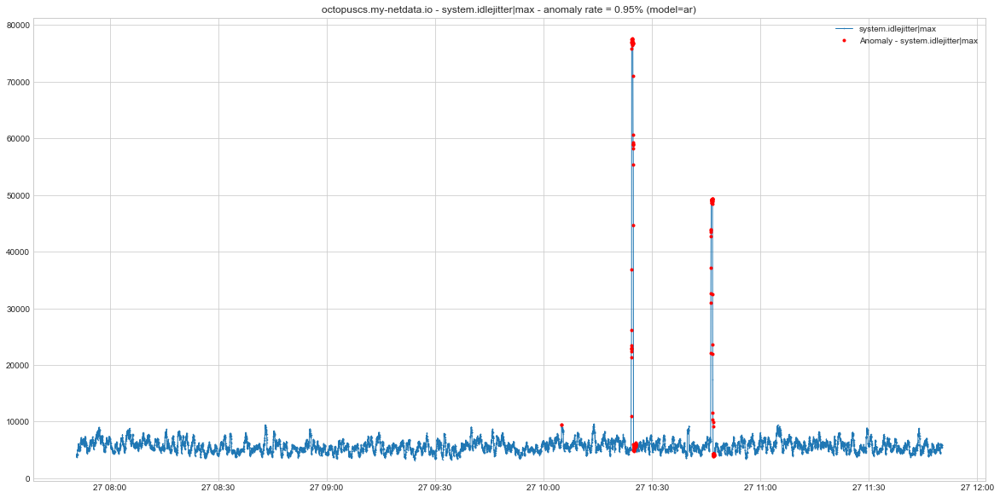

...

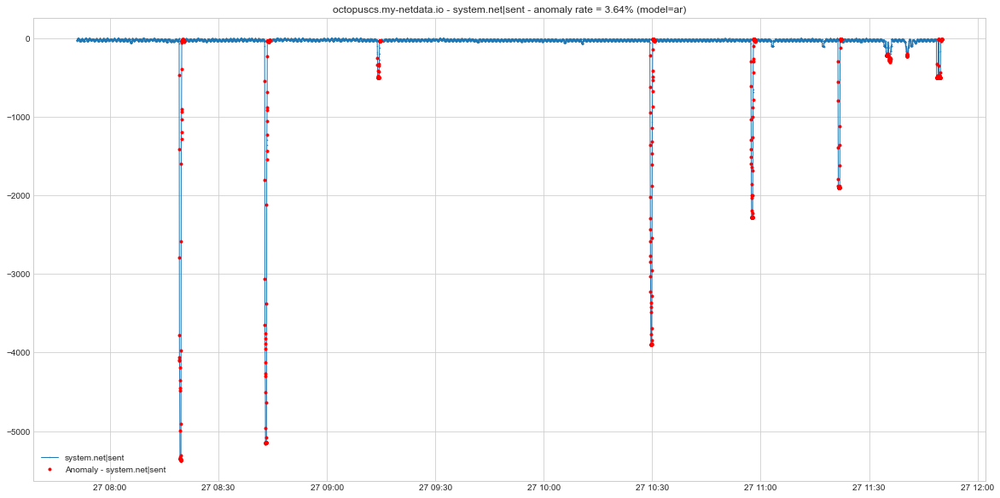

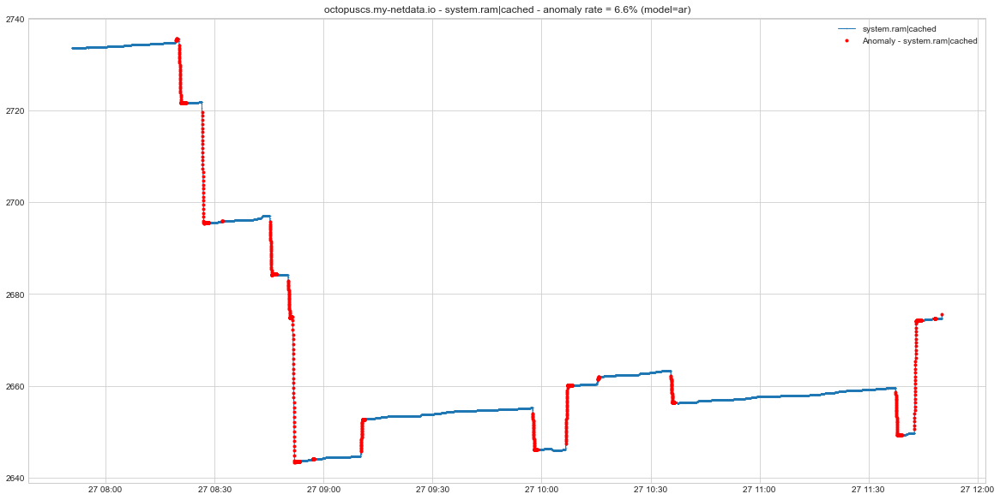

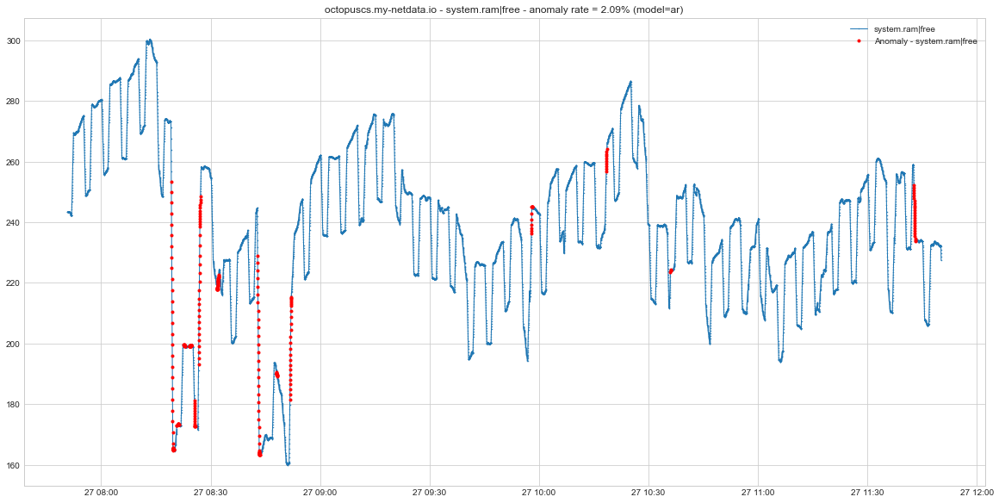

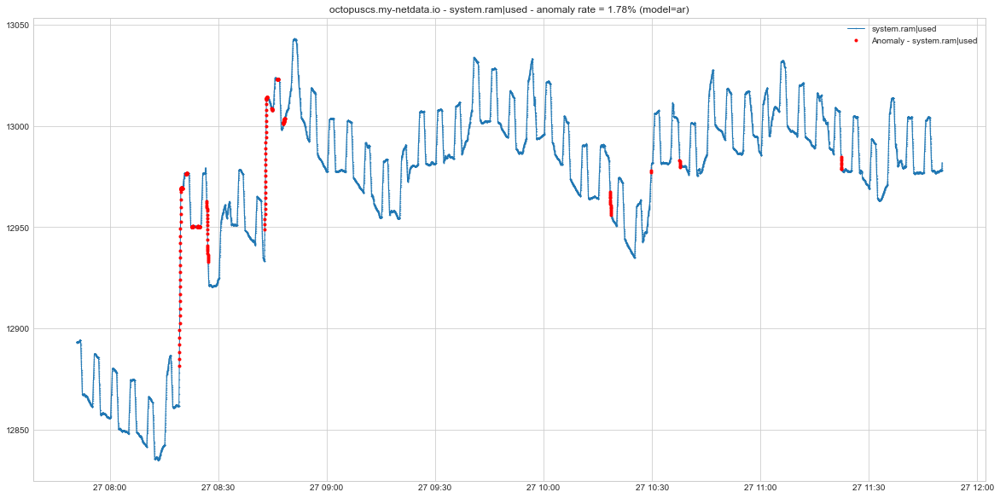

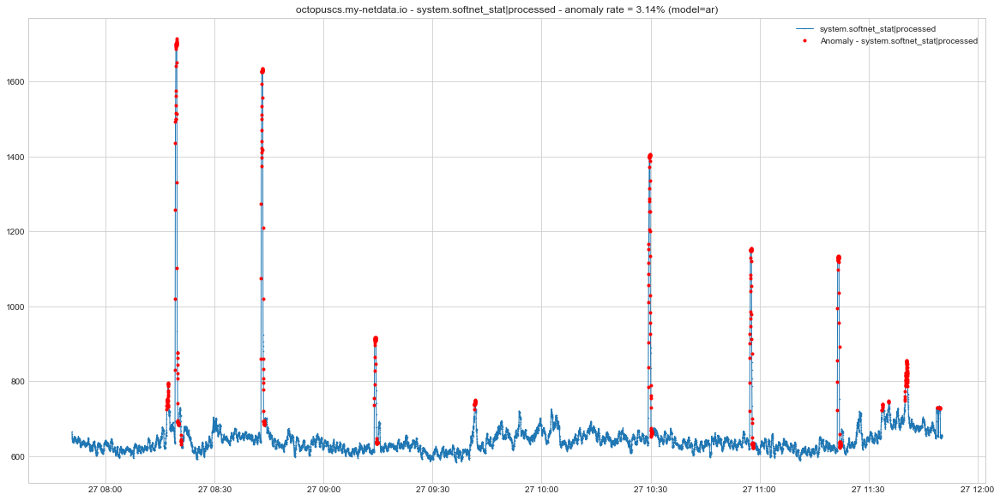

In [57]:
# lets do anomaly detection for each metric
metrics_in_scope = df.columns

# preprocess the data
df = preprocess_df(df, diff, smooth_n)

# loop over each metric and run detector
for metric in metrics_in_scope:
    detector = init_model(model, metric)
    try:
        # look for anomalies
        anomalies = detector.fit_detect(df[[metric]])
        num_obs = len(anomalies.dropna())
        num_anomalies = anomalies.dropna().values.sum()
        anomaly_rate = round(100 * (num_anomalies/num_obs), 2) 
        # plot anomalies found
        ax = plot(
            df[[metric]], anomaly=anomalies, ts_linewidth=1, ts_markersize=1, anomaly_markersize=3, 
            anomaly_color='red', anomaly_tag="marker", figsize=(20,10))
        ax[0].set_title(f'{host[0]} - {metric} - anomaly rate = {anomaly_rate}% (model={model})')
    except Exception as e:
        print(e)
        print(f'... fit_detect failed for model={model}, metric={metric}')
